In [ ]:
#IMPORT LIBRARIES
import sqlite3
import os
import pandas as pd
import numpy as np
from numpy import linalg as LA
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
from sklearn.impute import KNNImputer
from sklearn.cluster import KMeans, AgglomerativeClustering, MeanShift, DBSCAN, estimate_bandwidth
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler, StandardScaler, OneHotEncoder, LabelEncoder
from itertools import product
from math import ceil
from scipy.cluster.hierarchy import dendrogram
%matplotlib inline
from pandas_profiling import ProfileReport 
%config InlineBackend.figure_format = 'retina' 
from scipy.stats import iqr as IQR
from collections import Counter
import scipy.stats as stat
from sklearn.neighbors import NearestNeighbors

# Seeting seaborn style
sns.set()

In [ ]:
!pip install pandas-profiling

Collect initial data

In [ ]:
!pip install openpyxl

In [13]:
#import file excel
df = pd.read_excel('WonderfulWinesoftheWorld.xlsx')
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

In [14]:
df = df.iloc[0:10000,0:29]

### Describe, explore and assess data quality

In [15]:
df.head()

,Custid,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend
0,5325.0,653.0,55.0,20.0,78473.0,0.0,0.0,20.0,18.0,826.0,445.0,7.0,67.0,4.0,26.0,2.0,1.0,1.0,36.0,5.0,0,0,0,0,0,0,0,0,0
1,3956.0,1041.0,75.0,18.0,105087.0,0.0,0.0,36.0,33.0,1852.0,539.0,2.0,49.0,0.0,46.0,1.0,3.0,0.0,20.0,4.0,0,0,0,1,0,0,0,0,0
2,3681.0,666.0,18.0,12.0,27984.0,1.0,0.0,4.0,56.0,39.0,-7.0,88.0,4.0,29.0,14.0,32.0,21.0,48.0,60.0,8.0,0,0,0,0,0,0,0,0,0
3,2829.0,1049.0,42.0,16.0,61748.0,1.0,1.0,2.0,46.0,37.0,-6.0,70.0,86.0,1.0,11.0,1.0,1.0,55.0,59.0,7.0,0,0,0,0,0,0,0,1,1
4,8788.0,837.0,47.0,16.0,65789.0,0.0,1.0,2.0,3.0,36.0,4.0,35.0,85.0,0.0,12.0,2.0,1.0,28.0,63.0,6.0,0,0,0,0,0,0,0,0,0


In [16]:
df.tail()

,Custid,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend
9995,1383.0,1132.0,57.0,20.0,81033.0,0.0,1.0,19.0,59.0,776.0,187.0,22.0,78.0,0.0,20.0,1.0,1.0,11.0,27.0,4.0,1,0,0,0,0,1,0,1,0
9996,4070.0,596.0,66.0,15.0,84714.0,0.0,0.0,18.0,45.0,720.0,391.0,5.0,30.0,12.0,36.0,10.0,12.0,13.0,18.0,2.0,0,0,0,0,0,0,0,0,0
9997,7909.0,619.0,18.0,12.0,40466.0,0.0,0.0,3.0,65.0,47.0,5.0,23.0,6.0,24.0,10.0,38.0,22.0,41.0,58.0,5.0,0,0,0,0,0,0,0,0,0
9998,4158.0,1107.0,33.0,16.0,53661.0,1.0,0.0,1.0,368.0,15.0,2.0,35.0,18.0,13.0,45.0,11.0,13.0,13.0,60.0,6.0,0,0,0,0,0,0,0,0,0
9999,4914.0,979.0,55.0,16.0,94926.0,0.0,1.0,25.0,28.0,1148.0,293.0,7.0,63.0,10.0,13.0,11.0,3.0,4.0,34.0,5.0,0,0,0,0,0,0,0,0,0


In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 29 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Custid       10000 non-null  float64
 1   Dayswus      10000 non-null  float64
 2   Age          10000 non-null  float64
 3   Edu          10000 non-null  float64
 4   Income       10000 non-null  float64
 5   Kidhome      10000 non-null  float64
 6   Teenhome     10000 non-null  float64
 7   Freq         10000 non-null  float64
 8   Recency      10000 non-null  float64
 9   Monetary     10000 non-null  float64
 10  LTV          10000 non-null  float64
 11  Perdeal      10000 non-null  float64
 12  Dryred       10000 non-null  float64
 13  Sweetred     10000 non-null  float64
 14  Drywh        10000 non-null  float64
 15  Sweetwh      10000 non-null  float64
 16  Dessert      10000 non-null  float64
 17  Exotic       10000 non-null  float64
 18  WebPurchase  10000 non-null  float64
 19  WebVi

In [18]:
# Summary statistics for all variables
df.describe(include='all').transpose()

,count,mean,std,min,25%,50%,75%,max
Custid,10000.0,6000.5000,2886.895680,1001.0,3500.75,6000.5,8500.25,11000.0
Dayswus,10000.0,898.1020,202.492789,550.0,723.75,894.0,1074.00,1250.0
Age,10000.0,47.9273,17.302721,18.0,33.00,48.0,63.00,78.0
Edu,10000.0,16.7391,1.876375,12.0,15.00,17.0,18.00,20.0
Income,10000.0,69904.3580,27612.233311,10000.0,47642.00,70012.0,92147.00,140628.0
Kidhome,10000.0,0.4188,0.493387,0.0,0.00,0.0,1.00,1.0
Teenhome,10000.0,0.4698,0.499112,0.0,0.00,0.0,1.00,1.0
Freq,10000.0,14.6281,11.969073,1.0,4.00,12.0,24.00,56.0
Recency,10000.0,62.4068,69.874255,0.0,26.00,52.0,78.25,549.0
Monetary,10000.0,622.5552,647.135323,6.0,63.00,383.0,1077.00,3052.0


In [19]:
df.replace("", np.nan, inplace=True)

In [20]:
#FUNCTION TO SHOW MISSING VALUES AND THEIR PERCENTAGES
def missing_data(df):
    l = []
    for col in df.columns:
        missing = df[col].isnull().sum(axis=0)
        percentage = missing/df.shape[0]
        l.append([col,missing,percentage*100])
        df_missing = pd.DataFrame(l, columns = ['Feature','missing','percentage'])
        df_missing = df_missing.sort_values('missing',axis=0, ascending = False)    
    return df_missing

In [21]:
df_missing = missing_data(df)
df_missing = df_missing[df_missing['missing']>0]
df_missing

,Feature,missing,percentage


In [22]:
# Check duplicated observations
df.loc[df.duplicated(keep=False), :]

,Custid,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend


In [24]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 29 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Custid       10000 non-null  float64
 1   Dayswus      10000 non-null  float64
 2   Age          10000 non-null  float64
 3   Edu          10000 non-null  float64
 4   Income       10000 non-null  float64
 5   Kidhome      10000 non-null  float64
 6   Teenhome     10000 non-null  float64
 7   Freq         10000 non-null  float64
 8   Recency      10000 non-null  float64
 9   Monetary     10000 non-null  float64
 10  LTV          10000 non-null  float64
 11  Perdeal      10000 non-null  float64
 12  Dryred       10000 non-null  float64
 13  Sweetred     10000 non-null  float64
 14  Drywh        10000 non-null  float64
 15  Sweetwh      10000 non-null  float64
 16  Dessert      10000 non-null  float64
 17  Exotic       10000 non-null  float64
 18  WebPurchase  10000 non-null  float64
 19  WebVi

In [25]:
df1 = df.copy()

In [26]:
non_metric_features = ['SMRack','LGRack','Humid','Spcork','Bucket','Complain','Mailfriend','Emailfriend','Kidhome','Teenhome']
metric_features = df1.columns.drop(non_metric_features).to_list()

# Visualization/Correlations

In [37]:
#PANDAS PROFILING.

ProfileReport(df1)

C:\Users\debor\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\debor\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\debor\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\debor\anaconda3\lib\si

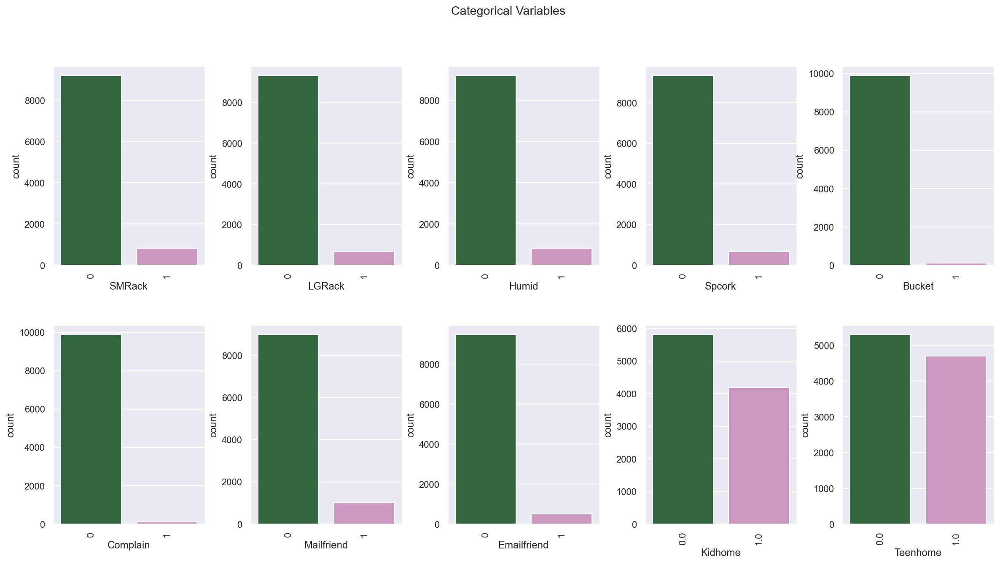

In [38]:
# All Non-Metric Variables' Absolute Frequencies
sns.set()

# Prepare figure. Create individual axes where each bar plot will be placed
fig, axes = plt.subplots(2, ceil(len(non_metric_features) / 2), figsize=(20, 10))

# Plot data
# Iterate across axes objects and associate each bar plot (hint: use the ax argument):
for ax, feat in zip(axes.flatten(), non_metric_features):
    g = sns.countplot(df1[feat], ax=ax, palette = 'cubehelix')
    g.set_xticklabels(g.get_xticklabels(),rotation=90)

title = "Categorical Variables"
plt.suptitle(title)
plt.subplots_adjust(wspace=0.3, hspace=0.3)

#Remove the last graphic
#axes.flatten()[-1].remove()

plt.show()

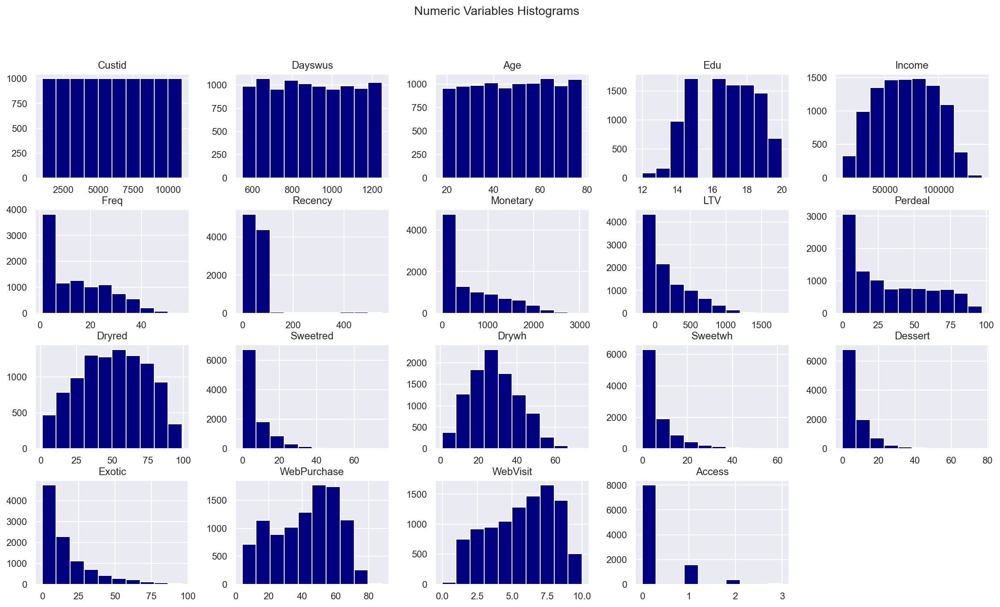

In [33]:
# All Numeric Variables' Histograms in one figure
sns.set()

# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(4, ceil(len(metric_features) / 4), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each histogram:
for ax, feat in zip(axes.flatten(), metric_features): 
    ax.hist(df1[feat], color = "Navy")
    ax.set_title(feat)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables Histograms"
plt.suptitle(title)
#Adjust the space between plots
plt.subplots_adjust(wspace=0.3, hspace=0.3)

#Remove the last  graphic
axes.flatten()[-1].remove()
#axes.flatten()[-2].remove()
plt.show()

C:\Users\debor\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\debor\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\debor\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\debor\anaconda3\lib\si

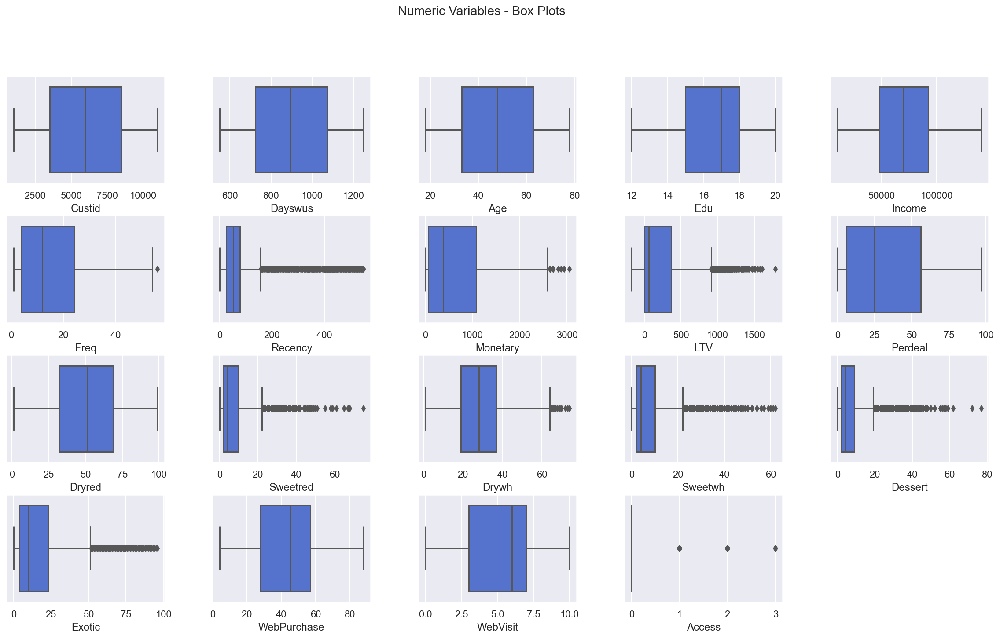

In [36]:
# All Numeric Variables Box Plots in one figure
sns.set()

# Prepare figure. Create individual axes where each box plot will be placed
fig, axes = plt.subplots(4, ceil(len(metric_features) /4), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each box plot
for ax, feat in zip(axes.flatten(), metric_features):
    sns.boxplot(df1[feat], ax=ax,color="royalblue")
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables - Box Plots"

plt.suptitle(title)

#Adjust the space between plots
plt.subplots_adjust(wspace=0.3, hspace=0.3)

#Remove the last  graphic
axes.flatten()[-1].remove()
plt.show()

In [ ]:
# Pairwise Relationship of Numerical Variables
sns.set()
features = metric_features

# Setting pairplot
sns.pairplot(data=df[features], hue='y', diag_kind="hist")

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables by Target", fontsize=20)

plt.show()

In [45]:
correlation = np.round(df1[metric_features].corr(),2)
correlation

,Custid,Dayswus,Age,Edu,Income,Freq,Recency,Monetary,LTV,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,Access
Custid,1.00,-0.00,0.00,0.00,0.00,0.00,0.00,0.00,-0.00,-0.00,0.00,-0.01,0.01,0.00,-0.01,0.01,-0.00,-0.00,-0.00
Dayswus,-0.00,1.00,-0.02,-0.00,-0.02,0.17,-0.04,0.17,0.10,0.02,0.01,-0.00,-0.01,-0.01,-0.01,0.02,0.02,0.30,-0.01
Age,0.00,-0.02,1.00,0.21,0.93,0.83,-0.18,0.81,0.76,-0.75,0.25,-0.26,0.03,-0.26,-0.26,-0.51,-0.79,-0.69,0.28
Edu,0.00,-0.00,0.21,1.00,0.20,0.12,-0.05,0.12,0.10,-0.12,0.50,-0.45,-0.07,-0.45,-0.45,-0.38,-0.10,-0.08,0.04
Income,0.00,-0.02,0.93,0.20,1.00,0.87,-0.18,0.85,0.79,-0.78,0.23,-0.24,0.03,-0.24,-0.24,-0.49,-0.73,-0.65,0.34
Freq,0.00,0.17,0.83,0.12,0.87,1.00,-0.20,0.99,0.92,-0.77,0.09,-0.14,0.10,-0.15,-0.15,-0.41,-0.74,-0.53,0.43
Recency,0.00,-0.04,-0.18,-0.05,-0.18,-0.20,1.00,-0.16,-0.12,0.16,-0.08,0.05,0.04,0.06,0.06,0.09,0.14,0.09,-0.05
Monetary,0.00,0.17,0.81,0.12,0.85,0.99,-0.16,1.00,0.94,-0.74,0.06,-0.12,0.13,-0.13,-0.13,-0.39,-0.74,-0.53,0.44
LTV,-0.00,0.10,0.76,0.10,0.79,0.92,-0.12,0.94,1.00,-0.72,-0.01,-0.07,0.17,-0.08,-0.08,-0.35,-0.72,-0.56,0.42
Perdeal,-0.00,0.02,-0.75,-0.12,-0.78,-0.77,0.16,-0.74,-0.72,1.00,-0.09,0.10,-0.03,0.10,0.11,0.37,0.67,0.58,-0.26


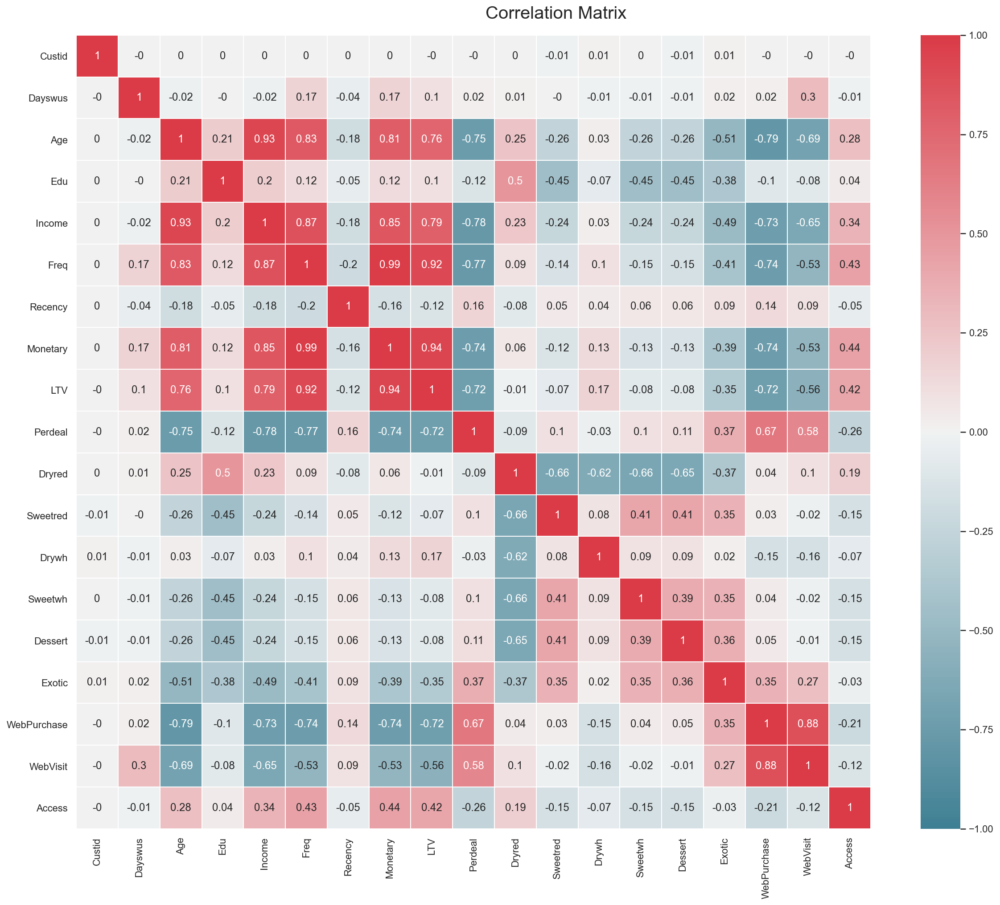

In [46]:
#Correlation matrix
fig = plt.figure(figsize=(20, 15))
sns.heatmap(data=correlation, annot = correlation.values,cmap=sns.diverging_palette(220, 10, as_cmap=True), 
             vmin=-1, vmax=1, center=0, square=True, linewidths=.5)
fig.subplots_adjust(top=0.95)
fig.suptitle("Pearson Correlation Matrix", fontsize=20)

plt.show()

In [43]:
corr_features =["Age", "Income","Monetary","LTV", 'SMRack','LGRack','Humid','Spcork','Bucket', 'Complain',
                'Mailfriend','Emailfriend']

interval columns not set, guessing: ['Age', 'Income', 'Monetary', 'LTV', 'SMRack', 'LGRack', 'Humid', 'Spcork', 'Bucket', 'Complain', 'Mailfriend', 'Emailfriend']


<AxesSubplot:>

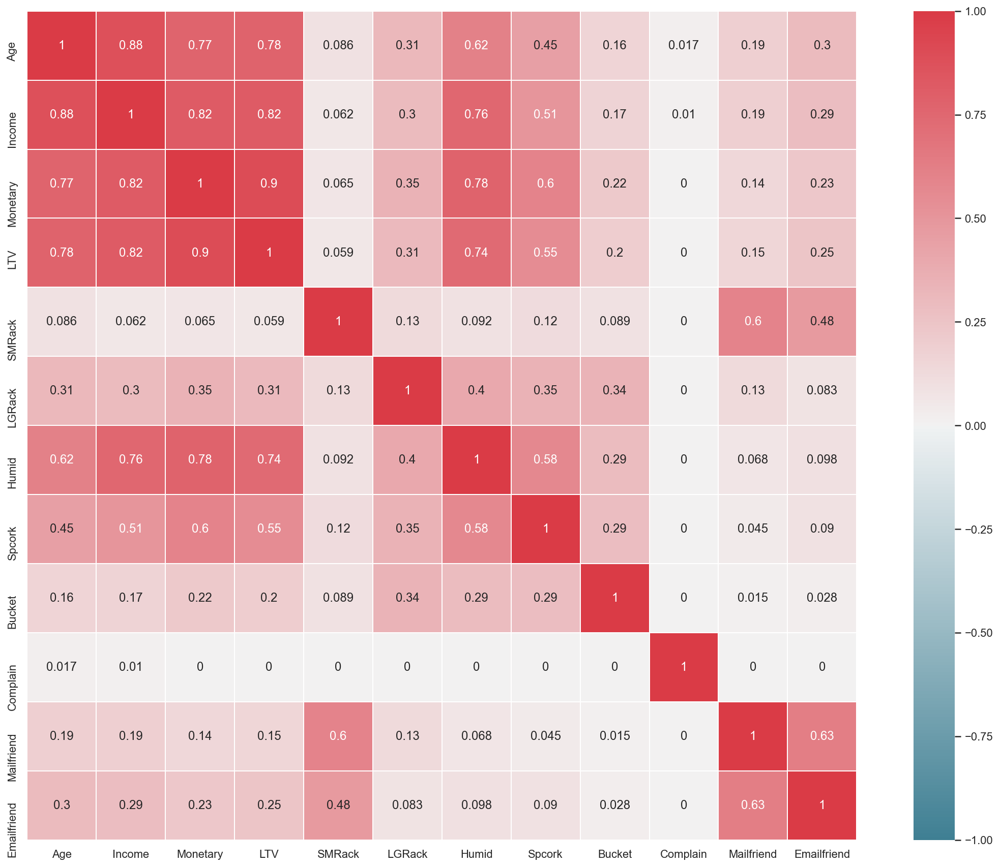

In [53]:
correlation2 = df1[corr_features].phik_matrix()
fig = plt.figure(figsize=(20, 15))
sns.heatmap(correlation2,annot = correlation2.values,cmap=sns.diverging_palette(220, 10, as_cmap=True),
            vmin=-1, vmax=1, center=0, square=True, linewidths=.5)
fig.subplots_adjust(top=0.95)
fig.suptitle("Phik Correlation Matrix", fontsize=20)

plt.show()

## Data Preparation:

In [54]:
#Set index
df1= df1.set_index('Custid')

### Clean data

In [57]:
# Droping duplicated rows
df1.drop_duplicates(inplace=True)

In [58]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Float64Index: 10000 entries, 5325.0 to 4914.0
Data columns (total 28 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Dayswus      10000 non-null  float64
 1   Age          10000 non-null  float64
 2   Edu          10000 non-null  float64
 3   Income       10000 non-null  float64
 4   Kidhome      10000 non-null  float64
 5   Teenhome     10000 non-null  float64
 6   Freq         10000 non-null  float64
 7   Recency      10000 non-null  float64
 8   Monetary     10000 non-null  float64
 9   LTV          10000 non-null  float64
 10  Perdeal      10000 non-null  float64
 11  Dryred       10000 non-null  float64
 12  Sweetred     10000 non-null  float64
 13  Drywh        10000 non-null  float64
 14  Sweetwh      10000 non-null  float64
 15  Dessert      10000 non-null  float64
 16  Exotic       10000 non-null  float64
 17  WebPurchase  10000 non-null  float64
 18  WebVisit     10000 non-null  float64
 

In [ ]:
# Droping irelevant columns
df1.drop(['contact', 'month', 'day_of_week', 'duration', 'emp.var.rate', 'cons.price.idx',
         'cons.conf.idx', 'euribor3m', 'nr.employed'], axis=1, inplace=True)


In [ ]:
#re-do non_metric and metric due to drop columns
non_metric_features = ['job','marital','education','default','housing','loan','poutcome','y']
metric_features = df1.columns.drop(non_metric_features).to_list()

In [ ]:
df1.shape

In [ ]:
df1.head()

### Outlier Removal

In [ ]:
#IQR Method
q25 = df1.quantile(.25)
q75 = df1.quantile(.75)
iqr = (q75 - q25)

 

upper_lim = q75 + 1.5 * iqr
lower_lim = q25 - 1.5 * iqr

 

filters2 = []
for metric in metric_features:
    llim = lower_lim[metric]
    ulim = upper_lim[metric]
    filters2.append(df1[metric].between(llim, ulim, inclusive=True))


filters2 = pd.Series(np.all(filters2,0))

print(filters2.value_counts())
print('Percentage of data kept after removing outliers:', filters2.value_counts()[1] / df1.shape[0], 4)

In [ ]:
#hand made outliers

filters1 = (

    

    (df1['campaign']<=42)
    #&
    #(df1['cons.conf.idx']<=-29)

   
)
df2 = df1[filters1]
print('Percentage of data kept after removing outliers:', np.round(df2.shape[0] / df1.shape[0], 4))

In [ ]:
#Replace df1 by the method we decide
#IQR method
#df1 = df1[filters2]
#Hand made
df1 = df2.copy()

In [ ]:
#Check boxplots after outliers removal
# All Numeric Variables' Box Plots in one figure
sns.set()

# Prepare figure. Create individual axes where each box plot will be placed
fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each box plot (hint: use the ax argument):
for ax, feat in zip(axes.flatten(), metric_features):
    sns.boxplot(df1[feat], ax=ax,color="royalblue")
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables"

plt.suptitle(title)

plt.show()

### Encoding categorical features

In [ ]:
# One hot encode categorical features
ohc_features = non_metric_features.copy()
#Remove the target feature
ohc_features.remove('y')

ohc = OneHotEncoder(sparse=False)
df_ohc = pd.DataFrame(ohc.fit_transform(df1[ohc_features]),
                      index=df1.index,
                      columns=ohc.get_feature_names(ohc_features))

In [ ]:
df1 = pd.concat([df1.loc[:, df1.columns.drop(ohc_features)], df_ohc], axis=1)

In [ ]:
df1['y'] = df1['y'].replace('no',0)
df1['y'] = df1['y'].replace('yes',1)

In [ ]:
df1.head(20)

## PCA

In [ ]:
df_pca = df1.copy()
df_pca.shape

In [ ]:
#Standardize the data
features = df_pca.columns
#MinMax
#norm = MinMaxScaler().fit(df_pca)
#df-pca = norm.transform(df_pca)
#Standar scale
#sds = StandardScaler()
#scaled_feat = sds.fit_transform(df4[metric_features])
#df4[metric_features]= scaled_feat
#df4.head()
scale = StandardScaler().fit_transform(df_pca[features])
df_pca[features] = scale
#RobustScaler instanceand fit to your train data
#robust = RobustScaler().fit(df_pca)
#df_pca = robust.transform(df_pca)

In [ ]:
df_pca.describe().apply(lambda s: s.apply(lambda x:format(x,'g')))

In [ ]:
df_pca.head(20)

In [ ]:
pca = PCA()
pca_feat = pca.fit_transform(df_pca)

In [ ]:
cov_matrix= df_pca.cov()
cov_matrix

In [ ]:
pd.DataFrame(pca.components_.T @ np.diag(pca.explained_variance_) @ pca.components_, 
             index=cov_matrix.index, 
             columns=cov_matrix.columns)

In [ ]:
pd.DataFrame(df_pca.values @ pca.components_.T, 
             index=df_pca.index,
             columns=[f"PC{i}" for i in range(pca.n_components_)])

In [ ]:
pd.DataFrame(
    {"Eigenvalue": pca.explained_variance_,
     "Difference": np.insert(np.diff(pca.explained_variance_), 0, 0),
     "Proportion": pca.explained_variance_ratio_,
     "Cumulative": np.cumsum(pca.explained_variance_ratio_)},
    index=range(1, pca.n_components_ + 1)
)

In [ ]:
# figure and axes
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

# draw plots
ax1.plot(pca.explained_variance_, marker=".", markersize=12)
ax2.plot(pca.explained_variance_ratio_, marker=".", markersize=12, label="Proportion")
ax2.plot(np.cumsum(pca.explained_variance_ratio_), marker=".", markersize=12, linestyle="--", label="Cumulative")

# customizations
ax2.legend()
ax1.set_title("Scree Plot", fontsize=14)
ax2.set_title("Variance Explained", fontsize=14)
ax1.set_ylabel("Eigenvalue")
ax2.set_ylabel("Proportion")
ax1.set_xlabel("Components")
ax2.set_xlabel("Components")
ax1.set_xticks(range(0, pca.n_components_, 2))
ax1.set_xticklabels(range(1, pca.n_components_ + 1, 2))
ax2.set_xticks(range(0, pca.n_components_, 2))
ax2.set_xticklabels(range(1, pca.n_components_ + 1, 2))

plt.show()

In [ ]:
# Perform PCA again with the number of principal components you want to retain
pca_features = list(df_pca.columns)
pca = PCA(n_components=3)
pca_feat = pca.fit_transform(df_pca[pca_features])
pca_feat_names = [f"PC{i}" for i in range(pca.n_components_)]
pca_df = pd.DataFrame(pca_feat, index=df_pca.index, columns=pca_feat_names)
pca_df

In [ ]:
df_pca2 = pd.concat([df_pca, pca_df], axis=1)

In [ ]:
def _color_red_or_green(val):
    if val < -0.45:
        color = 'background-color: red'
    elif val > 0.45:
        color = 'background-color: green'
    else:
        color = ''
    return color

# Interpreting each Principal Component
loadings = df_pca2[pca_features + pca_feat_names].corr().loc[pca_features, pca_feat_names]
loadings.style.applymap(_color_red_or_green)

In [ ]:
df_pca=df_pca.drop(pca_features,axis = 1)

In [ ]:
df1 = pd.concat([df_pca, pca_df], axis=1)

In [ ]:
df1.head()

In [ ]:
df1.shape

In [ ]:
#Concat all datas in one data set
df_preprocessed = df1.copy()

In [ ]:
df_preprocessed.head()

In [ ]:
df_preprocessed.describe().apply(lambda s: s.apply(lambda x:format(x,'g')))

In [ ]:
df_preprocessed.shape

In [ ]:
#Export CSV to use in cluster file
df_preprocessed.to_csv(os.path.join("df_preprocessed.csv"), index=False)